# Imports

In [59]:
%autosave 180
#Imports
import random
import os
import numpy as np
import torch
from matplotlib import pyplot as plt
import pickle
from skimage.filters import threshold_otsu, threshold_local
import cv2
import time

from sklearn.metrics import confusion_matrix

import torch.nn as nn
import torch.nn.functional as F

from PIL import Image
from PIL import ImageOps
from torch.utils.data import Dataset, DataLoader
from torch import autograd
from torch.autograd import Variable
from torch.utils.data import Sampler
import torchvision.transforms.functional as TF
from torchvision import transforms, utils

Autosaving every 180 seconds


# Dataset creation

In [3]:
class MASS_Roads_Dataset(Dataset):
    def __init__(self, data_dir, split):
        #store filenames
        self.filenames = os.listdir(os.path.join(data_dir, "sat"))
        self.filenames = sorted(self.filenames)
        #store file path
        self.filenames = [os.path.join(os.path.join(data_dir, "sat"), f) for f in self.filenames]
        
        #store labels (maps)
        self.labels = os.listdir(os.path.join(data_dir, "map"))
        self.labels = sorted(self.labels)
        #store label path
        self.labels = [os.path.join(os.path.join(data_dir, "map"), l) for l in self.labels]
        self.split = split
        
        self.rand_img = [random.randint(0,1107) for _ in range(131072)]
        
    #data augnemtation transforms
    def transform(self, image, mask):
        
        #contrast normalize image
        image = ImageOps.autocontrast(image, cutoff=0)

        # Random horizontal flipping
        if random.random() > 0.5:
            image = TF.hflip(image)
            mask = TF.hflip(mask)

        # Random vertical flipping
        if random.random() > 0.5:
            image = TF.vflip(image)
            mask = TF.vflip(mask)
        
        #perform center crop of image
        #mask = TF.center_crop(mask, 16)
        
        # Transform to tensor
        image = TF.to_tensor(image)
        mask = TF.to_tensor(mask)
        #print(mask.shape)
        #mask = mask.view(1,256)
        mask = mask.view(4096)
        
        return image, mask, (torch.nonzero(mask).size(0)/256)
    
    def __len__(self):
        #return size of dataset
        self.rand_img = [random.randint(0,1107) for _ in range(131072)]
        return len(self.rand_img)
    
    def valid_patch_road(self, np_label_patch, not_valid_road_count):

        im = Image.fromarray(np_label_patch)

        white = 0

        for pixel in im.getdata():
            if pixel == (255): # check if road
                white += 1
        #print(white)     
        if(white==0):
            not_valid_road_count += 1
            return False, not_valid_road_count
        else:
            return True, not_valid_road_count

    def valid_patch_img(self, np_img_patch, np_label_patch, not_valid_road_count, not_valid_patch):
        
        #if we cant find a patch after searching 30 times take any patch
        if(not_valid_patch>30):
            return True, not_valid_road_count, not_valid_patch

        im = Image.fromarray(np_img_patch)

        white = 0
        size = ((np_img_patch.size)*3/4)/3 # if white pixels are greater than 3 quarters of image. Div by 3 because of 3 channels

        for pixel in im.getdata():
            if pixel == (255, 255, 255): # if all 3 channels only have 1 pixel
                white += 1
        #if 10 searchers yeild no result
        if(not_valid_road_count<20):
            valid_road, not_valid_road_count = self.valid_patch_road(np_label_patch, not_valid_road_count)
            #print(not_valid_road_count)
            if(not valid_road):
                return False, not_valid_road_count, not_valid_patch

        if(white>size):
            not_valid_patch += 1
            return False, not_valid_road_count, not_valid_patch
        else:
            return True, not_valid_road_count, not_valid_patch

    def patch_selection(self, img, label, pixel_bound):
        # takes in image and label pil images
        x, y = random.randint(0, pixel_bound), random.randint(0, pixel_bound)
        
        img_numpy = np.array(img)
        label_numpy = np.array(label)
        #extract patch
        img_patch = img_numpy[x:x+64,y:y+64,:]
        label_patch = label_numpy[x:x+64,y:y+64]
        #stop searching for road if too many miss
        not_valid_road_count = 0
        not_valid_patch = 0
        valid_patch, not_valid_road_count, not_valid_patch = self.valid_patch_img(img_patch, label_patch, not_valid_road_count, not_valid_patch)
        #check if paych is valid
        while(not valid_patch):
            x, y = random.randint(0, pixel_bound), random.randint(0, pixel_bound)
            
            img_patch = img_numpy[x:x+64,y:y+64,:]
            label_patch = label_numpy[x:x+64,y:y+64]
            
            valid_patch, not_valid_road_count, not_valid_patch = self.valid_patch_img(img_patch, label_patch, not_valid_road_count, not_valid_patch)
        #image_numpy = None
        return Image.fromarray(img_patch), Image.fromarray(label_patch)
    
    def __getitem__(self, idx):
        #open an image, apply transform to the image and the map, return image with map
        random_idx = self.rand_img[idx]
        image = Image.open(self.filenames[random_idx])
        label = Image.open(self.labels[random_idx]) #maps
        ratio = 0
        
        if(self.split == "train"):
            image, label = self.patch_selection(image, label, 1434)
            image, label, ratio = self.transform(image, label)
        else:
            resize = transforms.Resize(size=(1024, 1024))
            image = resize(image)
            label = resize(label)
            image = TF.to_tensor(image)
            label = TF.to_tensor(label)
        return image, label, ratio

# Dataloader declaration

In [4]:
def fetch_dataloader(types, data_dir, params):
    """
    Fetches the DataLoader object for each type in types from data_dir.
    Args:
        types: (list) has one or more of 'train', 'val', 'test' depending on which data is required
        data_dir: (string) directory containing the dataset
        params: (Params) hyperparameters
    Returns:
        data: (dict) contains the DataLoader object for each type in types
    """
    dataloaders = {}

    for split in ['train', 'valid_split', 'test_split']:
        if split in types:
            path = os.path.join(data_dir, split)

            # use the train_transformer if training data, else use eval_transformer without random flip
            if split == 'train':
                
                mass_roads_dataset = MASS_Roads_Dataset(path, split)
                
                dl = DataLoader(mass_roads_dataset, batch_size=params['batch_size'], shuffle=True,
                                        num_workers=params['num_workers'],
                                        pin_memory=False)
            else:
                dl = DataLoader(MASS_Roads_Dataset(path, split), batch_size=params['batch_size'], shuffle=False,
                                num_workers=params['num_workers'],
                                pin_memory=False)

            dataloaders[split] = dl
    return dataloaders

# Hyper parms

In [5]:
torch.cuda.is_available()

True

In [6]:
params = {
    "batch_size": 128,
    "num_workers": 4,
}

# use GPU if available
params["cuda"] = torch.cuda.is_available()

# Set the random seed for reproducible experiments
#torch.manual_seed(230)
#if params['cuda']: torch.cuda.manual_seed(230)
    
dataloaders = fetch_dataloader(['train'], "../data/mass_roads", params)
train_dl = dataloaders['train']


In [7]:
print(params)

{'batch_size': 128, 'num_workers': 4, 'cuda': True}


In [8]:
train_dl
print(len(train_dl.dataset))

131072


# Mnih Architecture

In [9]:
class mnih_nn(nn.Module):
    
    def __init__(self):
        super(mnih_nn, self).__init__()
        # 3 input image channel,  output channels, 5x5 square convolution
        # kernel
        self.conv1 = nn.Conv2d(3, 64, 16, stride=4, bias = False)
        nn.init.xavier_uniform_(self.conv1.weight)
        #self.mp1 = nn.MaxPool2d(2)
        self.conv2 = nn.Conv2d(64, 112, 4, stride=1, bias = False)
        nn.init.xavier_uniform_(self.conv2.weight)
        self.conv3 = nn.Conv2d(112, 80, 3, stride=1, bias = False)
        nn.init.xavier_uniform_(self.conv3.weight)
        #self.conv4 = nn.Conv2d(80, 1, kernel_size = 1)
        # an affine operation: y = Wx + b
        self.fc4 = nn.Linear(5120, 4096, bias = False)
        nn.init.xavier_uniform_(self.fc4.weight)
        self.fc5 = nn.Linear(4096, 256, bias = False)
        nn.init.xavier_uniform_(self.fc5.weight)

    def forward(self, x):
        in_size = x.size(0)
        #print(x.shape, 'Input')
        #h = F.relu(self.mp1(self.conv1(x)))
        h = F.relu(self.conv1(x))
        #print(h.shape, 'Conv1')
        h = F.relu(self.conv2(h))
        #print(h.shape, 'Conv2')
        h = F.relu(self.conv3(h))
        #print(h.shape, 'Conv3')
        #h = F.relu(self.conv4(h))
        #print(h.shape, 'Conv4')
        h = h.view(-1, 5120)
        #print(h.shape, 'Reshape Voodoo')
        # If the size is a square you can only specify a single number
        h = F.dropout(F.relu(self.fc4(h)), training=False)
        #print(h.shape, 'Linear1')
        h = self.fc5(h)
        #print(h.shape, 'Linear2')
        #print(x.data.shape[0])
        #self.pred = F.reshape(h, (x.data.shape[0], 16, 16))
        self.pred = h.reshape(h.size(0), -1)
        self.pred = torch.sigmoid(self.pred)
        return self.pred

In [10]:
def weighted_binary_cross_entropy(output, target, weights=None):
    output = torch.clamp(output, min=1e-7, max = 1-1e-7)
        
    if weights is not None:
        assert len(weights) == 2
        
        log_1 = torch.log(output)
        #log_1[log_1 != log_1] = 0
        log_0 = torch.log(1 - output)
        #log_0[log_0 != log_0] = 0
        loss = weights[1] * (target * log_1) + \
               weights[0] * ((1 - target) * log_0)
    else:
        log_1 = torch.log(output)
        #log_1[log_1 != log_1] = 0
        log_0 = torch.log(1 - output)
        #log_0[log_0 != log_0] = 0
        
        loss = target * log_1 + (1 - target) * log_0

    return torch.neg(torch.mean(loss))

In [11]:
mnih_model = mnih_nn()
mnih_model.cuda()
optimizer = torch.optim.SGD(mnih_model.parameters(), lr = 0.001, momentum=0.9, weight_decay=0.001)

# Training loop

In [ ]:
mnih_model = torch.load('model_epoch_54.pt')

In [ ]:
for epoch in range(0,45):
    #print(epoch)
    running_loss = 0.0
    for i, data in enumerate(train_dl, 0):
        
        #get inputs
        inputs, masks = data
        #print("Iteration:", i," inputs: ", inputs.data.shape, "masks:", masks.data.shape)
        
        #wrap them in a variable
        inputs, masks = Variable(inputs).cuda(), (Variable(masks).cuda())
        
        #forward pass
        mask_pred = mnih_model(inputs)
        
        #compute and print loss
        loss = weighted_binary_cross_entropy(mask_pred, masks, weights = torch.Tensor([1, 1]).cuda()).cuda()
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # print statistics
        running_loss += loss.item()
        if i % 1023 == 0 and i > 0:    # print every 200 mini-batches
            #print(epoch, i, loss.item())
            print('[%d, %5d] loss: %.6f' %(epoch, i, running_loss / 1024))
            running_loss = 0.0
            
    if((epoch+1)%5 == 0 and i>0):
        print("saving weights")
        torch.save(mnih_model, "model_epoch_"+str(epoch+55)+".pt")
        #pickle.dump(test_model, open("model_epoch_"+str(i)+".pkl", "wb"))

print('Finished Training')


In [ ]:
# Started training on sunday 10:41
# ended at approx 0.234.... loss

# Accuracy

In [ ]:
#fix test data loading
dataloaders = fetch_dataloader(['test_split'], "../data/mass_roads", params)
testloader = dataloaders['test_split']

In [ ]:
correct = 0
total = 0
with torch.no_grad():
    for data in testloader:
        images, labels = data
        outputs = mnih_model(images)
        t = torch.Tensor([0.5])  # threshold
        outputs = (outputs > t).float() * 1
        diff = (labels - outputs).numpy()
        correct += np.count_nonzero(diff==0)
        total += diff.size

print('Accuracy of the network on the 396900  test images: %d %%' % (
    100 * correct / total))

## Import model and restructure for training phase 2

In [20]:
mnih_model = torch.load('useful_models/model_epoch_89.pt')

In [ ]:
child_counter = 0
for child in mnih_model.children():
   print(" child", child_counter, "is:")
   print(child)
   child_counter += 1

In [ ]:
# freeze layers 1-3

In [ ]:
child_counter = 0
for child in mnih_model.children():
    if child_counter < 3:
        for param in child.parameters():
            param.requires_grad = False
            print("child ",child_counter," was frozen")
    child_counter += 1

In [ ]:
mnih_model_fcn = nn.Sequential(*list(mnih_model.children())[:-2])

In [ ]:
child_counter = 0
for child in mnih_model_fcn.children():
   print(" child", child_counter, "is:")
   print(child)
   child_counter += 1

## Mnih FCN

In [11]:
mnih_model = torch.load('useful_models/model_epoch_89.pt')

In [12]:
class mnih_fcn(nn.Module):
    
    def __init__(self,mnih_model):
        super(mnih_fcn, self).__init__()
        
#         self.conv1 = nn.Conv2d(3, 64, 16, stride=4, bias = False)
#         nn.init.xavier_uniform_(self.conv1.weight)
#         #self.mp1 = nn.MaxPool2d(2)
#         self.conv2 = nn.Conv2d(64, 112, 4, stride=1, bias = False)
#         nn.init.xavier_uniform_(self.conv2.weight)
#         self.conv3 = nn.Conv2d(112, 80, 3, stride=1, bias = False)
        
        # 3 input image channel,  output channels, 5x5 square convolution
        # kernel
        self.conv1 = list(mnih_model.children())[0]

        self.conv2 = list(mnih_model.children())[1]
 
        self.conv3 = list(mnih_model.children())[2]

        self.conv4 = nn.Conv2d(80, 2, 1, stride=1, bias = False)
        
        self.deconv5 = nn.ConvTranspose2d(2, 80, 1, stride=1)
        
        self.deconv6 = nn.ConvTranspose2d(80, 112, 3, stride=1)
        
        self.deconv7 = nn.ConvTranspose2d(112, 64, 4, stride=1)
        
        self.deconv8 = nn.ConvTranspose2d(64, 1, 16, stride=4)
        
        

    def forward(self, x):
        in_size = x.size(0)
        #print(x.shape, 'Input')
        #h = F.relu(self.mp1(self.conv1(x)))
        h = F.relu(self.conv1(x))
        #print(h.shape, 'Conv1')
        h2 = F.relu(self.conv2(h))
        #print(h2.shape, 'Conv2')
        h3 = F.relu(self.conv3(h2))
        #print(h3.shape, 'Conv3')
        #h = F.relu(self.conv4(h))
        #print(h.shape, 'Conv4')
        h4 = F.relu(self.conv4(h3))
        #print(h4.shape, 'Conv4 1x1')
        
        h5 = F.relu(self.deconv5(h4))
        #print(h5.shape, 'DeConv5')
        
        h5 = h5 + h3
        
        h6 = F.relu(self.deconv6(h5))
        #print(h6.shape, 'DeConv6')
        
        h6 = h6 + h2
        
        h7 = F.relu(self.deconv7(h6))
        #print(h7.shape, 'DeConv7')
        h7 = h7 + h
        
        h8 = self.deconv8(h7)
        #print(h8.shape, 'DeConv8')

        self.pred = h8.reshape(h8.size(0), -1)
        self.pred = torch.sigmoid(self.pred)
        #print(self.pred.shape, 'Prediction')
        return self.pred

In [48]:
mnih_fcn_model = mnih_fcn(mnih_model)
mnih_fcn_model.cuda()
optimizer = torch.optim.SGD(mnih_fcn_model.parameters(), lr = 0.001, momentum=0.9, weight_decay=0.001)

child_counter = 0
for child in mnih_fcn_model.children():
    if child_counter < 3:
        for param in child.parameters():
            param.requires_grad = False
            print("child ",child_counter," was frozen")
    child_counter += 1

child  0  was frozen
child  1  was frozen
child  2  was frozen


## Testing dataset

## Training loop

In [10]:
mnih_fcn_model = torch.load("model_epoch_24.pt")
mnih_fcn_model.cuda()
optimizer = torch.optim.SGD(mnih_fcn_model.parameters(), lr = 0.001, momentum=0.9, weight_decay=0.001)

child_counter = 0
for child in mnih_fcn_model.children():
    if child_counter < 3:
        for param in child.parameters():
            param.requires_grad = False
            print("child ",child_counter," was frozen")
    child_counter += 1

child  0  was frozen
child  1  was frozen
child  2  was frozen


In [11]:
text_file = open("loss.txt", "w")
for epoch in range(25,50):
    #print(epoch)
#     if(epoch>0):
#         break
    running_loss = 0.0
    for i, data in enumerate(train_dl, 0):
#         if(i>0):
#             break
        
        #get inputs
        inputs, masks, ratio = data
        #print("Iteration:", i," inputs: ", inputs.data.shape, "masks:", masks.data.shape)
        
        #wrap them in a variablel
        inputs = Variable(inputs)#.pin_memory()
        masks =(Variable(masks).cuda(async=True))
        inputs = inputs.cuda()
        
        #forward pass
        mask_pred = mnih_fcn_model(inputs)
        
        #weight array
        ratio_road = torch.sum(ratio)/len(ratio) # how much to punish background incorrect prediction (ratio_road/ratio_road)
        ratio_road = (1-ratio_road)/ratio_road # how much to punish incorrect road prediction
        
#         print(ratio_road)
#         print(ratio)
#         print(torch.sum(ratio)/len(ratio))
#         print(ratio_road)
        if(ratio_road<1):
            ratio_road = 1
#         print(ratio_road)
        
        weight_arr = torch.Tensor([1,ratio_road])
        
        #compute and print loss
        loss = weighted_binary_cross_entropy(mask_pred, masks, weights = weight_arr.cuda()).cuda()
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # print statistics
        running_loss += loss.item()
        if i % 1023 == 0 and i > 0:    # print every 200 mini-batches
            #print(epoch, i, loss.item())
            print('[%d, %5d] loss: %.6f' %(epoch, i, running_loss / 1024))
            text_file.write('[%d, %5d] loss: %.6f \n' %(epoch, i, running_loss / 1024))
            running_loss = 0.0
        
        del inputs
        del masks
        del mask_pred
        del ratio
        torch.cuda.empty_cache()
            
    if((epoch+1)%5 == 0 and epoch>0):
        print("saving weights")
        torch.save(mnih_fcn_model, "model_epoch_"+str(epoch)+".pt")
        #pickle.dump(test_model, open("model_epoch_"+str(i)+".pkl", "wb"))

text_file.close()
print('Finished Training')


[25,  1023] loss: 0.230242
[26,  1023] loss: 0.230144
[27,  1023] loss: 0.230064
[28,  1023] loss: 0.229669
[29,  1023] loss: 0.229471
saving weights


/home/alterith/anaconda3/lib/python3.6/site-packages/torch/serialization.py:241: UserWarning: Couldn't retrieve source code for container of type mnih_fcn. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


[30,  1023] loss: 0.229234
[31,  1023] loss: 0.227833
[32,  1023] loss: 0.227361
[33,  1023] loss: 0.227666
[34,  1023] loss: 0.227138
saving weights
[35,  1023] loss: 0.226581
[36,  1023] loss: 0.226063
[37,  1023] loss: 0.226660
[38,  1023] loss: 0.225801
[39,  1023] loss: 0.225411
saving weights
[40,  1023] loss: 0.225474
[41,  1023] loss: 0.225704
[42,  1023] loss: 0.225957
[43,  1023] loss: 0.224436
[44,  1023] loss: 0.224197
saving weights
[45,  1023] loss: 0.224535
[46,  1023] loss: 0.224082
[47,  1023] loss: 0.223807
[48,  1023] loss: 0.224299
[49,  1023] loss: 0.224031
saving weights
Finished Training


# Test image show

In [13]:
class MASS_Roads_Dataset_test(Dataset):
    def __init__(self, data_dir, split):
        #store filenames
        self.filenames = os.listdir(os.path.join(data_dir, "sat"))
        self.filenames = sorted(self.filenames)
        #store file path
        self.filenames = [os.path.join(os.path.join(data_dir, "sat"), f) for f in self.filenames]
        
        #store labels (maps)
        self.labels = os.listdir(os.path.join(data_dir, "map"))
        self.labels = sorted(self.labels)
        #store label path
        self.labels = [os.path.join(os.path.join(data_dir, "map"), l) for l in self.labels]
        self.split = split
        
    def __len__(self):
        #return size of dataset
        return len(self.filenames)
    
  
    def __getitem__(self, idx):
        #open an image, apply transform to the image and the map, return image with map
        #random_idx = random.randint(0,len(self.filenames))
        image = Image.open(self.filenames[idx])
        label = Image.open(self.labels[idx]) #maps
        ratio = 0
        
        if(self.split == "train"):
            resize = transforms.Resize(size=(1024, 1024))
            image = resize(image)
            label = resize(label)
            image = TF.to_tensor(image)
            label = TF.to_tensor(label)
        else:
            #resize = transforms.Resize(size=(1440, 1440))
            #image = resize(image)
            #label = resize(label)
            image = TF.to_tensor(image)
            #image = image[24:1464, 24:1464]
            image = image.narrow(1, 24, 1440)
            image = image.narrow(2, 24, 1440)
            label = TF.to_tensor(label)
            #label = label[24:1464, 24:1464]
            label = label.narrow(1, 24, 1440)
            label = label.narrow(2, 24, 1440)
        return image, label, str(self.filenames[idx].split("/")[-1])

In [14]:
def fetch_dataloader_test(types, data_dir, params):
    """
    Fetches the DataLoader object for each type in types from data_dir.
    Args:
        types: (list) has one or more of 'train', 'val', 'test' depending on which data is required
        data_dir: (string) directory containing the dataset
        params: (Params) hyperparameters
    Returns:
        data: (dict) contains the DataLoader object for each type in types
    """
    dataloaders = {}

    for split in ['train', 'valid', 'test']:
        if split in types:
            path = os.path.join(data_dir, split)

            # use the train_transformer if training data, else use eval_transformer without random flip
            if split == 'train':
                
                mass_roads_dataset = MASS_Roads_Dataset_test(path, split)
                
                dl = DataLoader(mass_roads_dataset, batch_size=params['batch_size'], shuffle=True,
                                        num_workers=params['num_workers'],
                                        pin_memory=False)
            else:
                dl = DataLoader(MASS_Roads_Dataset_test(path, split), batch_size=params['batch_size'], shuffle=False,
                                num_workers=params['num_workers'],
                                pin_memory=False)

            dataloaders[split] = dl
    return dataloaders

In [15]:
params = {
    "batch_size": 1,
    "num_workers": 1,
}

# use GPU if available
params["cuda"] = torch.cuda.is_available()

# Set the random seed for reproducible experiments
#torch.manual_seed(230)
#if params['cuda']: torch.cuda.manual_seed(230)
    
dataloaders = fetch_dataloader_test(['test'], "../data/mass_roads", params)
testloader = dataloaders['test']

In [16]:
mnih_fcn_model_test = torch.load("model_epoch_99.pt")
mnih_fcn_model_test.cuda()

mnih_fcn(
  (conv1): Conv2d(3, 64, kernel_size=(16, 16), stride=(4, 4), bias=False)
  (conv2): Conv2d(64, 112, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (conv3): Conv2d(112, 80, kernel_size=(3, 3), stride=(1, 1), bias=False)
  (conv4): Conv2d(80, 2, kernel_size=(1, 1), stride=(1, 1), bias=False)
  (deconv5): ConvTranspose2d(2, 80, kernel_size=(1, 1), stride=(1, 1))
  (deconv6): ConvTranspose2d(80, 112, kernel_size=(3, 3), stride=(1, 1))
  (deconv7): ConvTranspose2d(112, 64, kernel_size=(4, 4), stride=(1, 1))
  (deconv8): ConvTranspose2d(64, 1, kernel_size=(16, 16), stride=(4, 4))
)

Iteration: 0  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
10378780_15.tiff
250.14213642055844


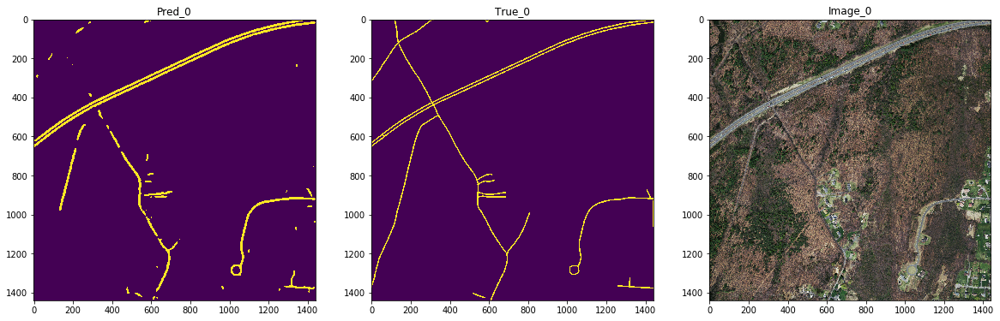

Iteration: 1  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
10828720_15.tiff
254.44864963988076


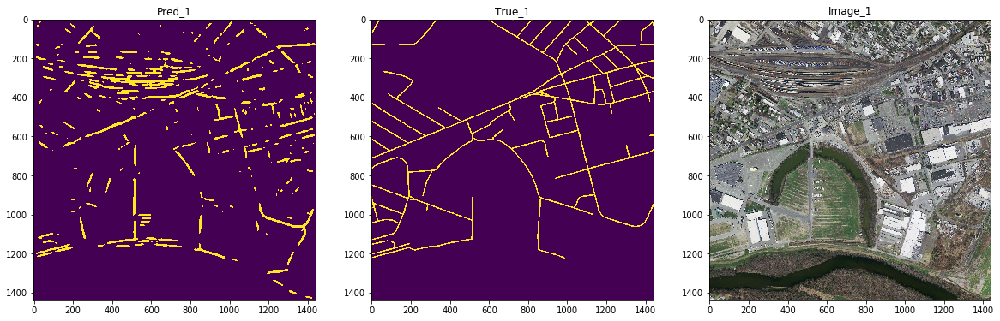

Iteration: 2  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
11128870_15.tiff
254.99051092312172


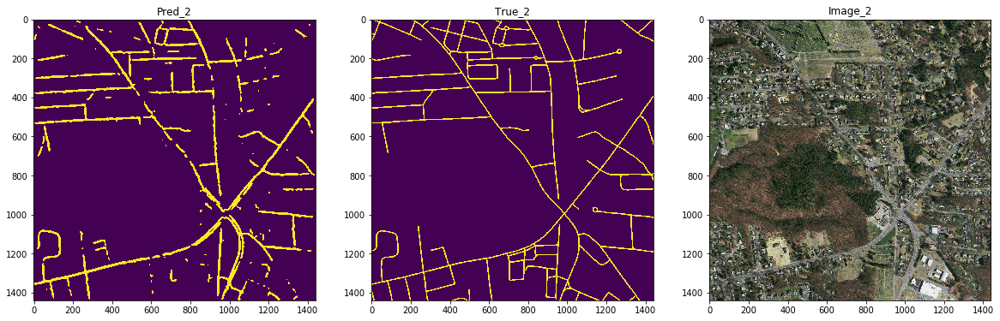

Iteration: 3  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
11278840_15.tiff
254.97757620156963


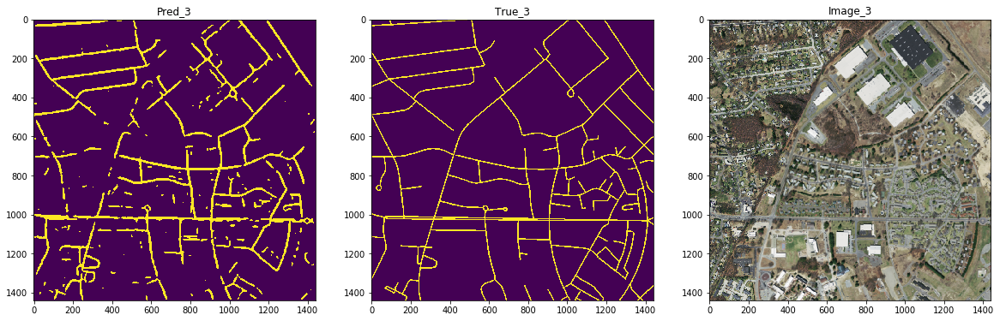

Iteration: 4  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
11728825_15.tiff
253.50235267817857


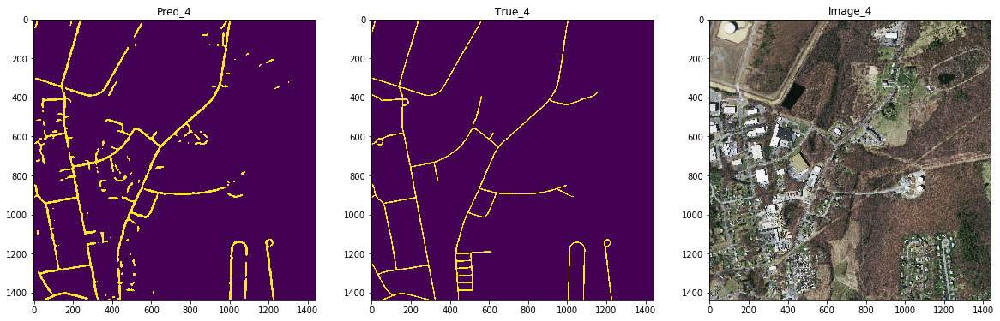

Iteration: 5  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
12328750_15.tiff
253.31452674421888


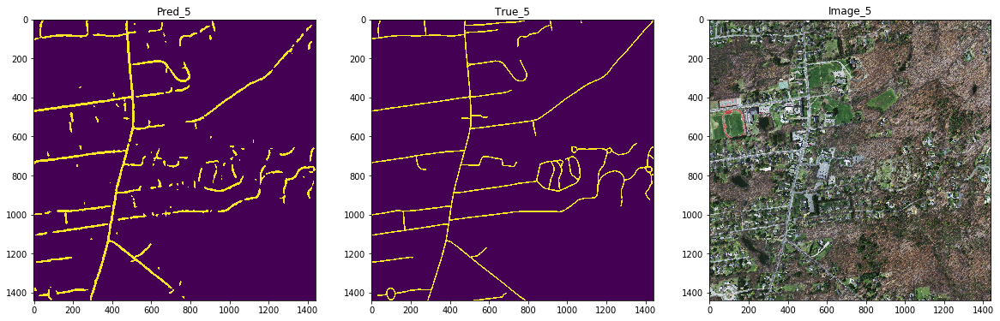

Iteration: 6  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
15928855_15.tiff
250.53156585585162


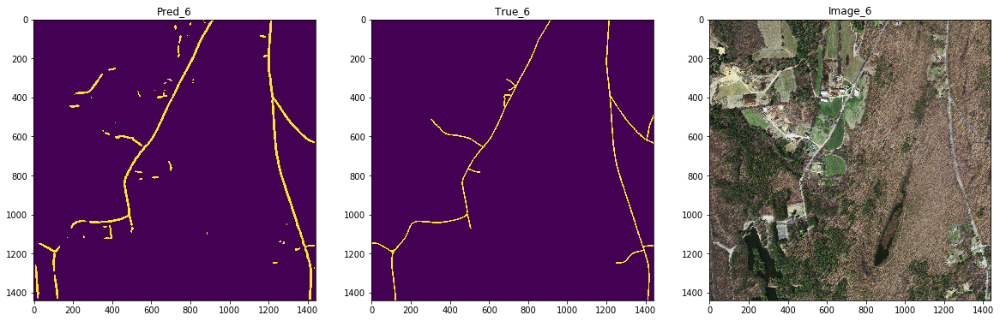

Iteration: 7  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
16078870_15.tiff
251.36106557298513


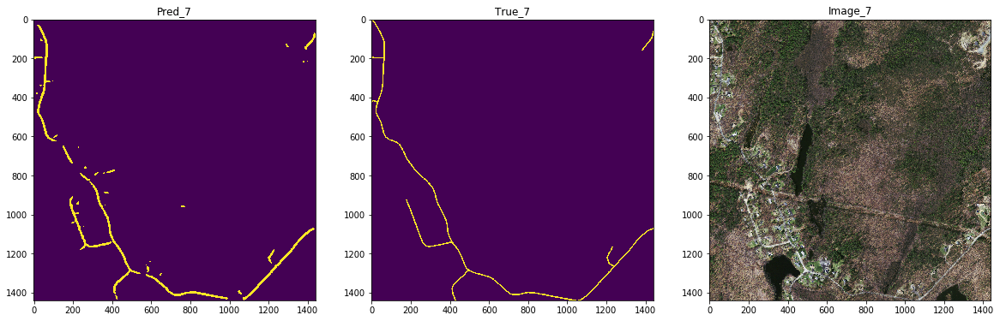

Iteration: 8  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
17878735_15.tiff
250.58451397098628


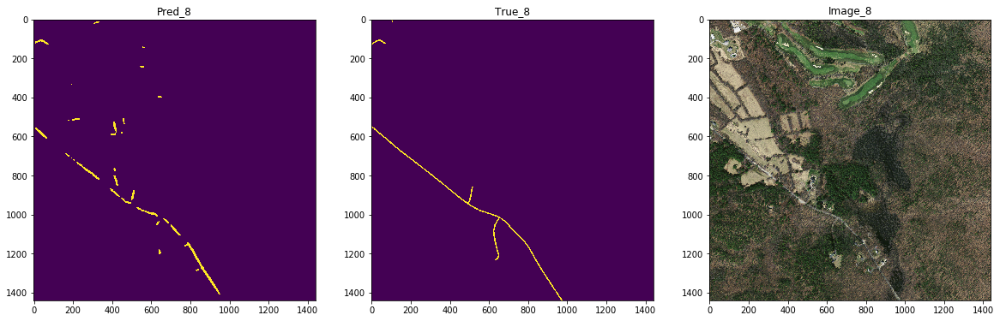

Iteration: 9  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
17878780_15.tiff
254.54888641025167


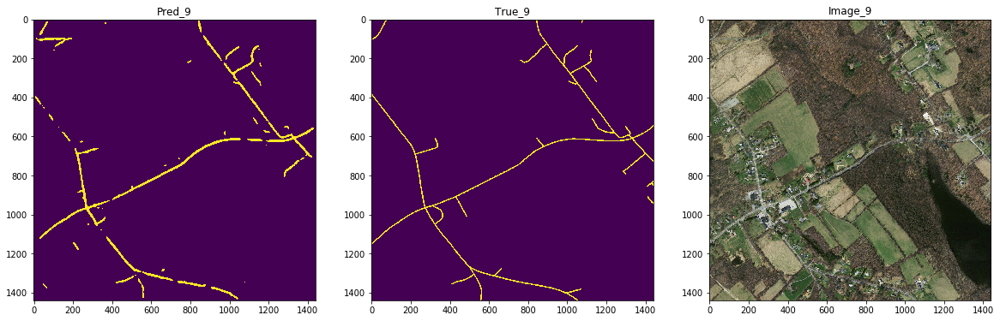

Iteration: 10  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
17878885_15.tiff
254.02945294769006


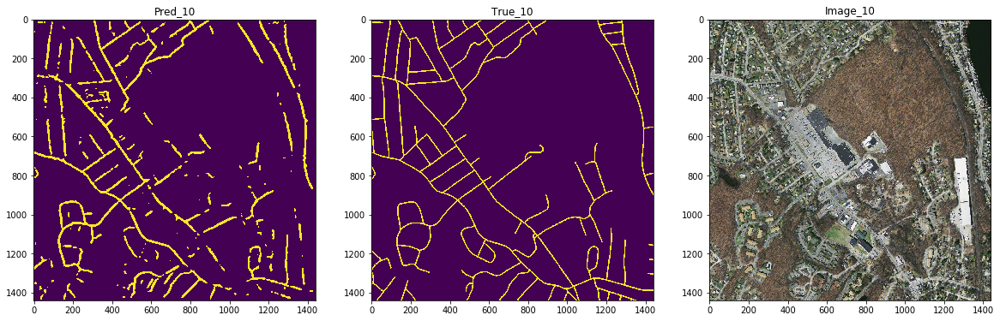

Iteration: 11  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
18028750_15.tiff
250.24597951251752


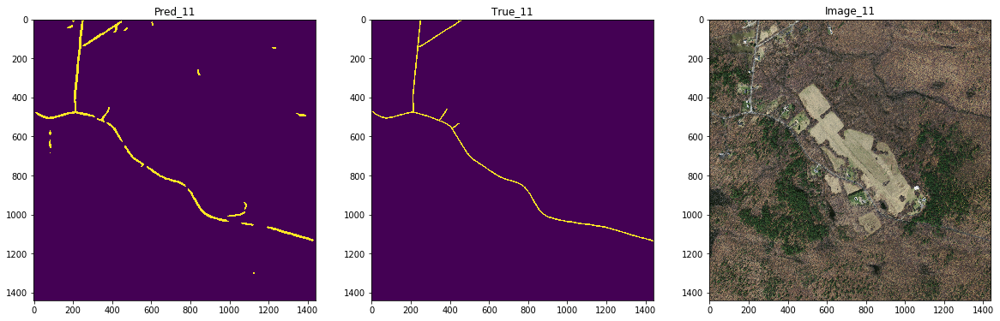

Iteration: 12  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
18178780_15.tiff
254.82868736342994


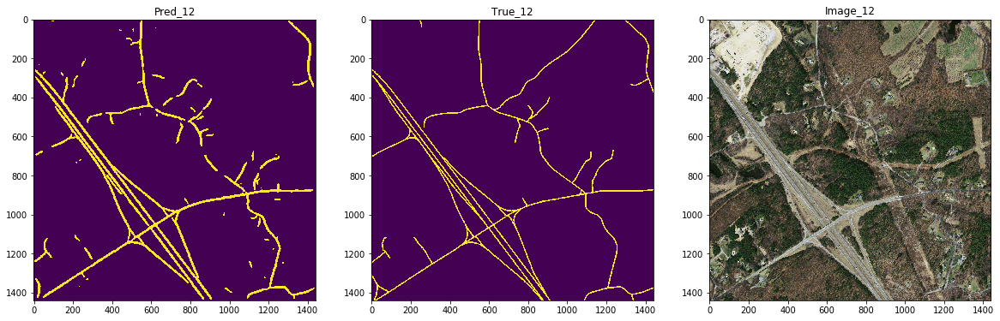

Iteration: 13  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
18328735_15.tiff
254.53213895841725


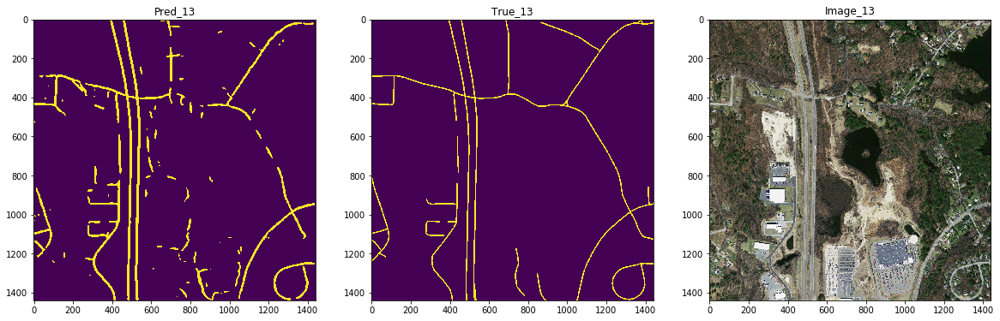

Iteration: 14  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
18328780_15.tiff
253.72354571198912


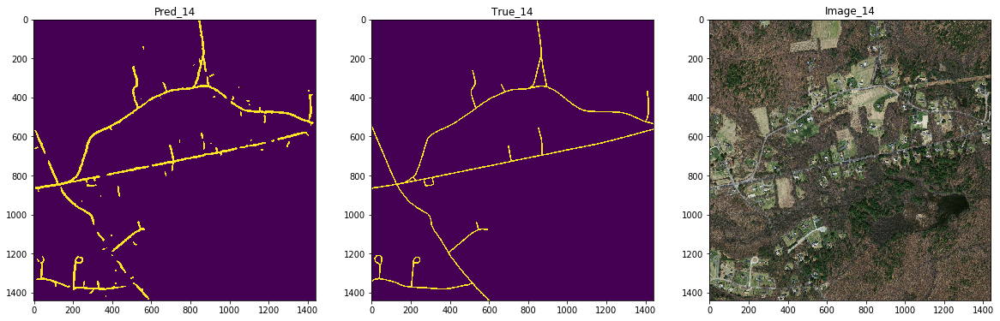

Iteration: 15  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
18328960_15.tiff
254.6842283346034


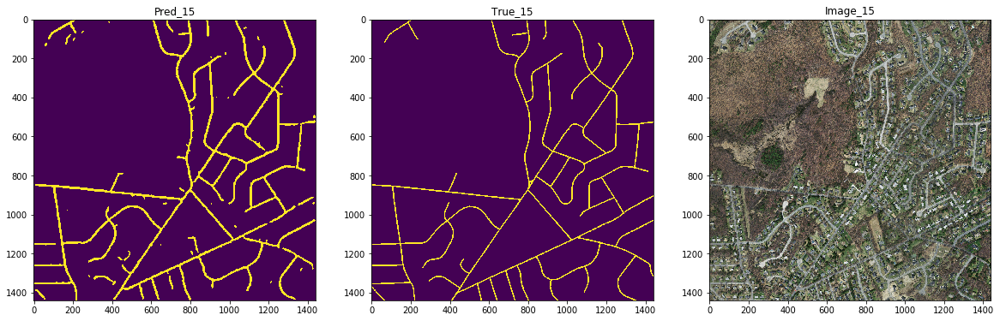

Iteration: 16  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
18478735_15.tiff
254.36044794072168


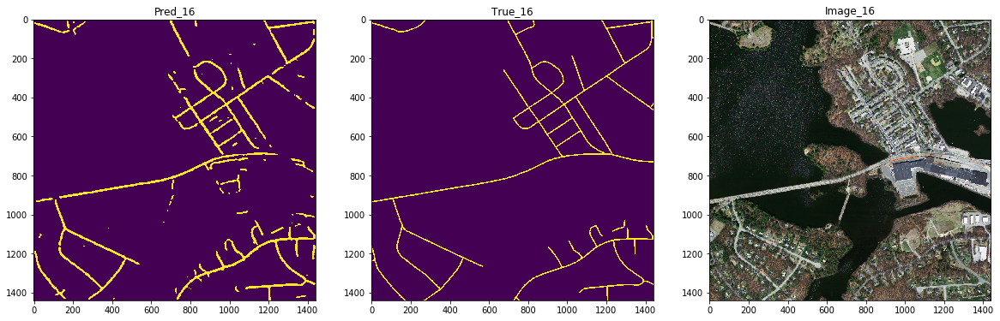

Iteration: 17  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
18478900_15.tiff
253.1670972137649


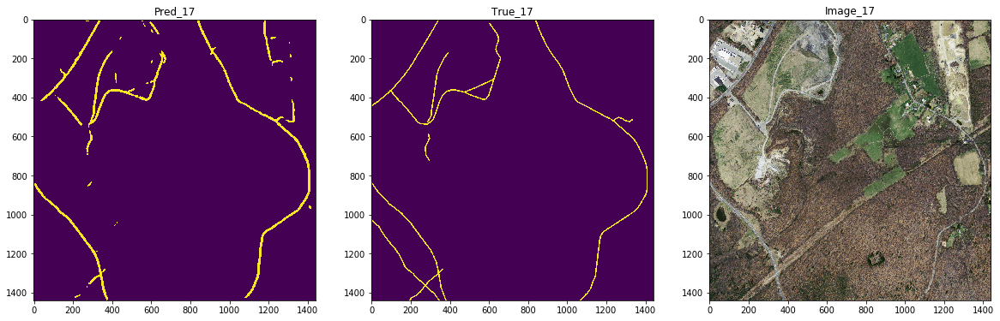

Iteration: 18  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
18478930_15.tiff
254.32521382927888


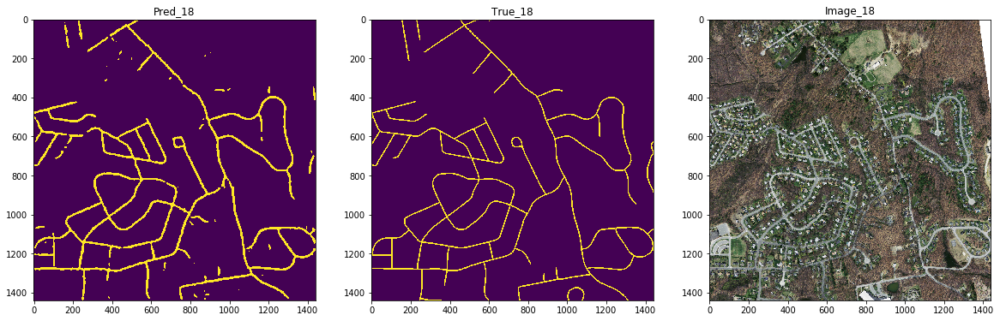

Iteration: 19  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
20278885_15.tiff
251.56975375460445


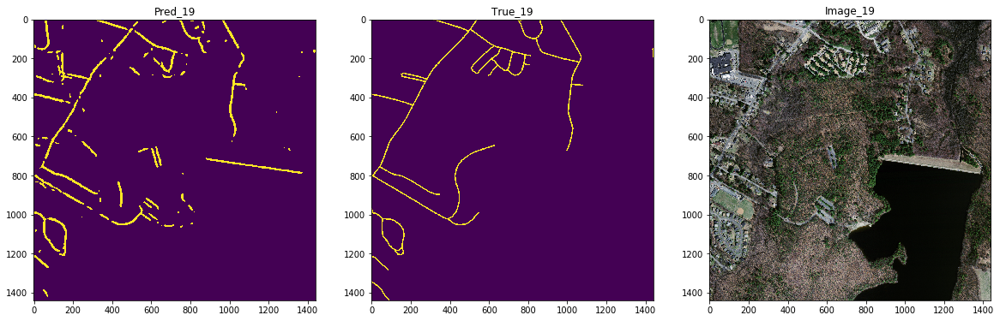

Iteration: 20  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
20728960_15.tiff
254.99992416386587


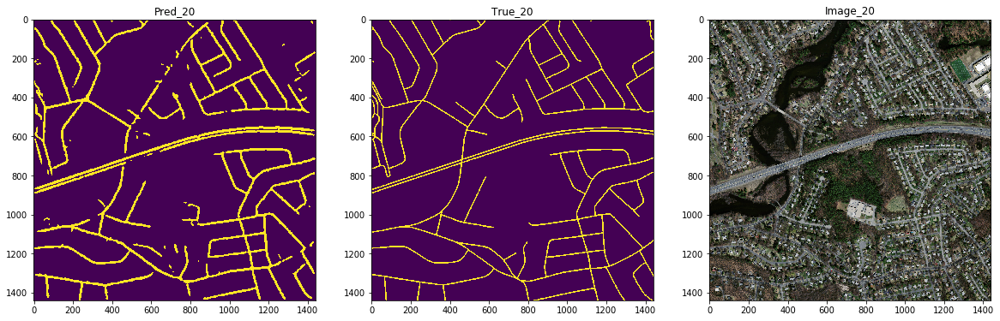

Iteration: 21  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
20878930_15.tiff
254.9368059848142


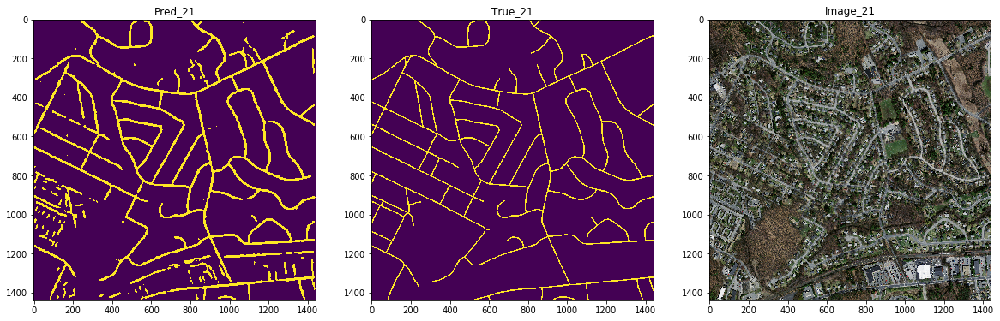

Iteration: 22  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
21479035_15.tiff
251.87610553832255


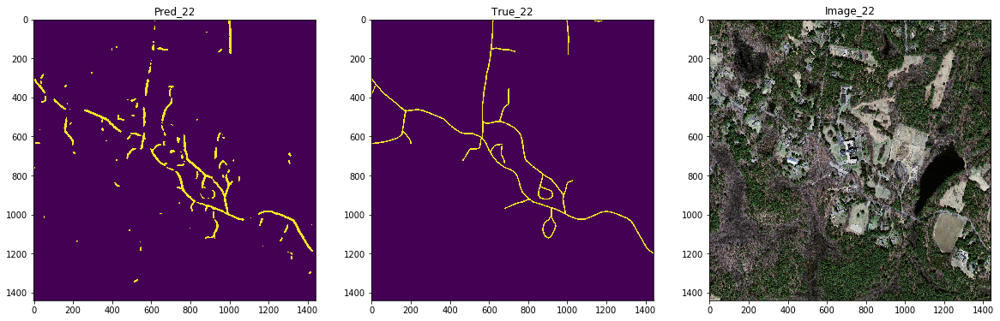

Iteration: 23  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
21779005_15.tiff
251.52695125027185


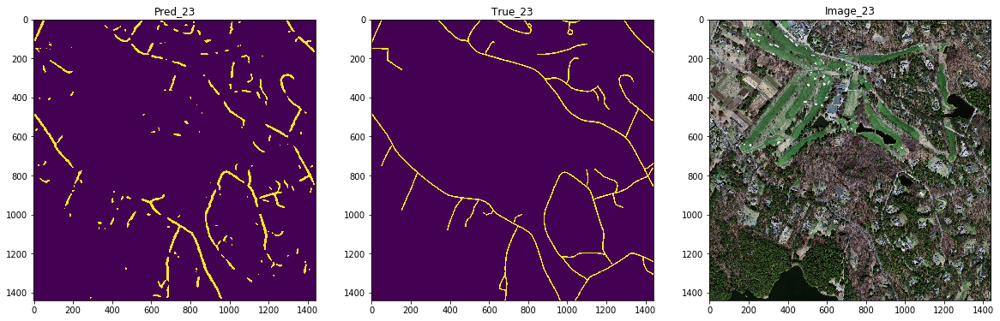

Iteration: 24  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
22078975_15.tiff
254.98952581729222


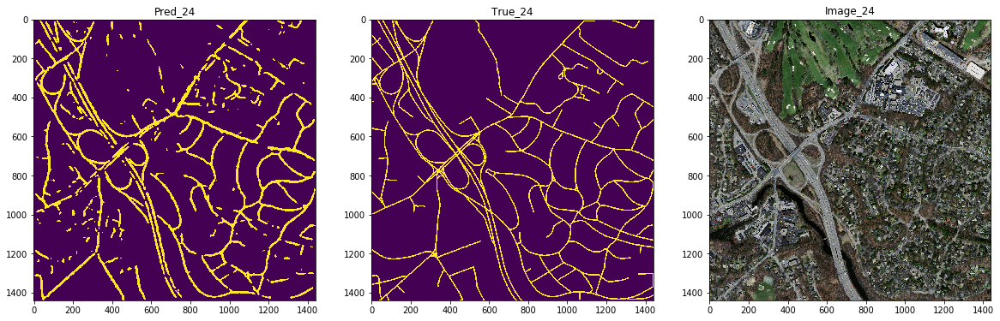

Iteration: 25  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
22228900_15.tiff
252.66882207134842


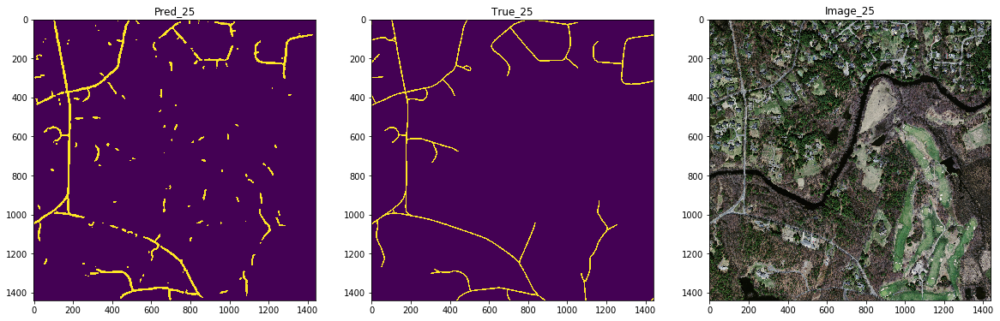

Iteration: 26  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
22229050_15.tiff
254.99639561343696


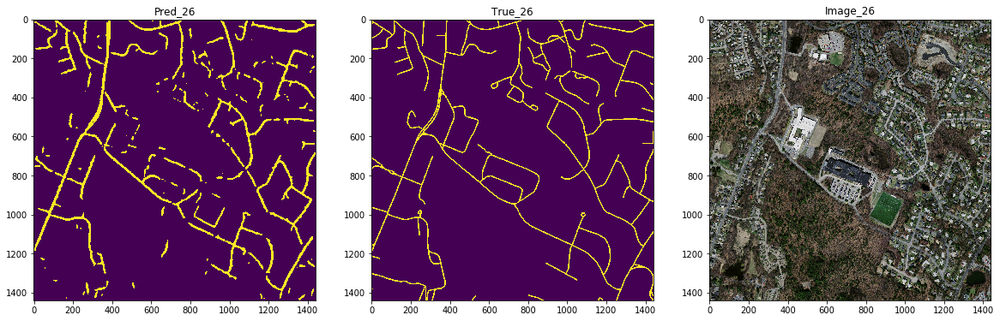

Iteration: 27  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
22528885_15.tiff
254.09110847959636


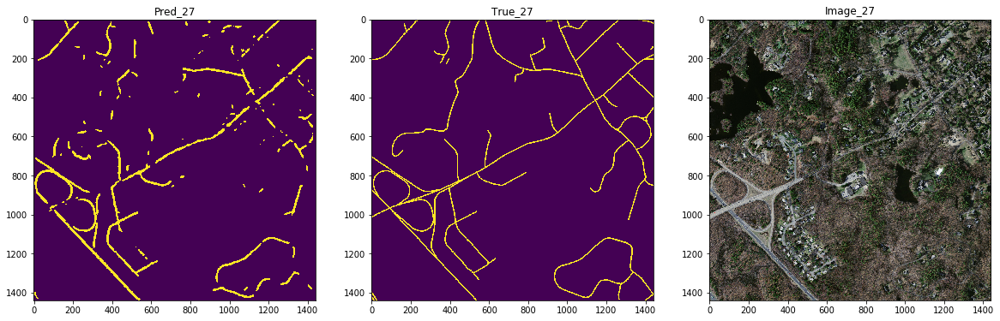

Iteration: 28  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
22529065_15.tiff
254.85296895400228


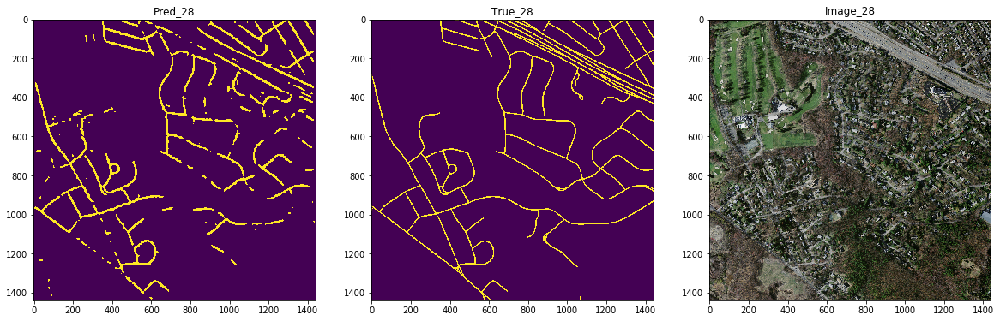

Iteration: 29  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
23278915_15.tiff
254.99999999999991


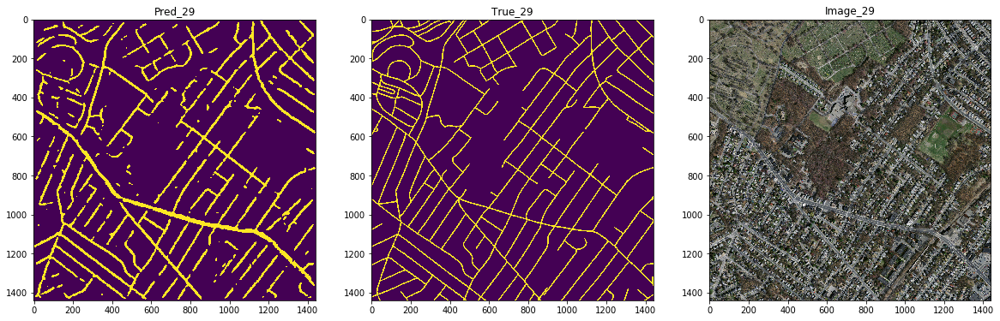

Iteration: 30  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
23278930_15.tiff
254.9492890493701


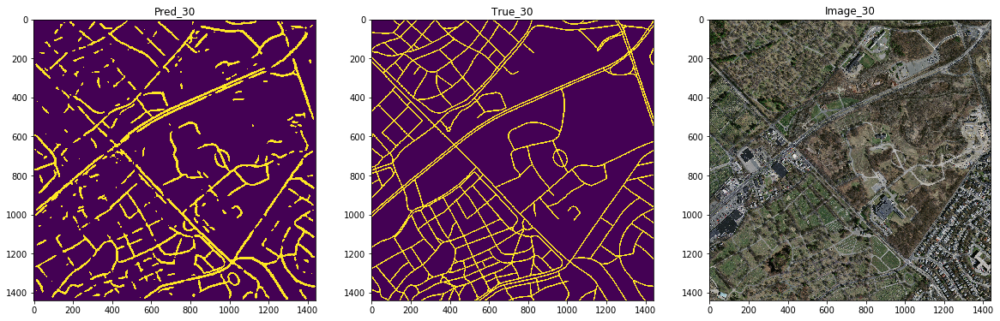

Iteration: 31  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
23428540_15.tiff
254.99957784748986


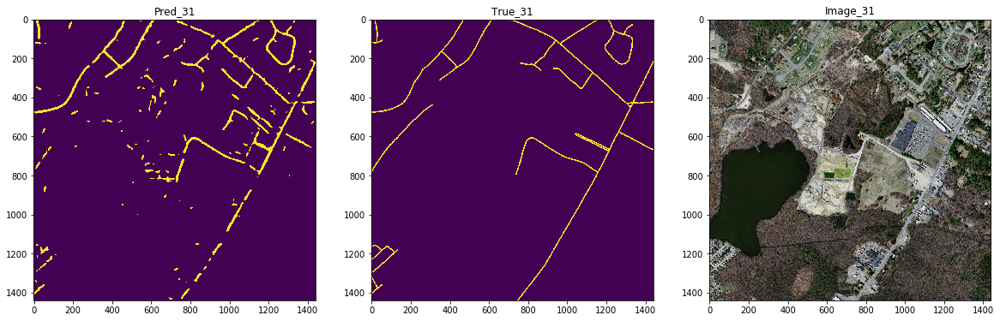

Iteration: 32  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
23428810_15.tiff
254.78855239664648


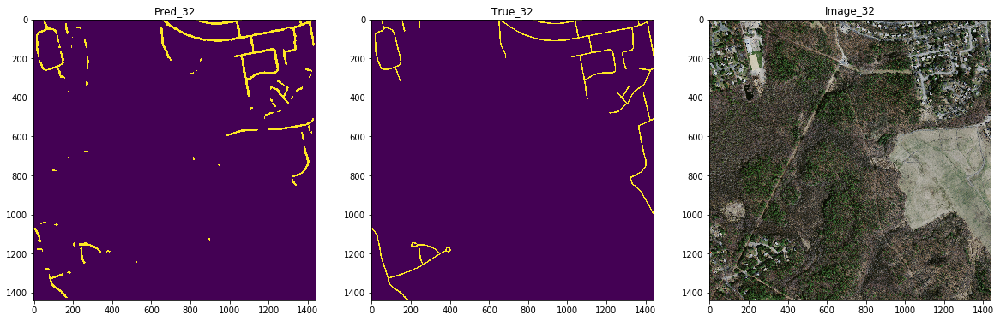

Iteration: 33  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
23429080_15.tiff
254.9972975391687


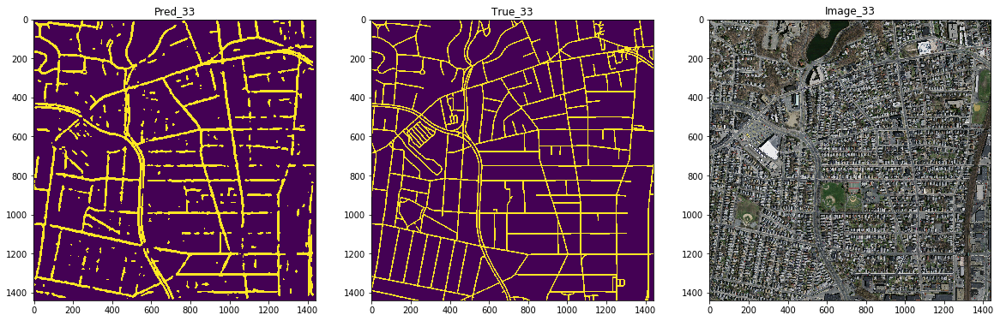

Iteration: 34  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
23729020_15.tiff
254.99862423194622


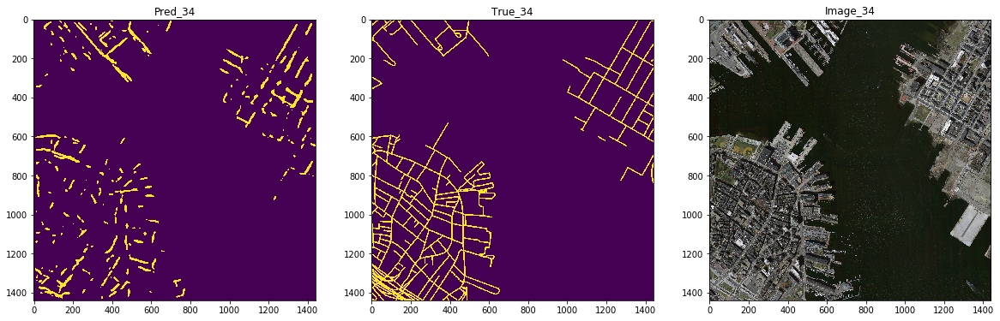

Iteration: 35  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
23878540_15.tiff
254.1778476630389


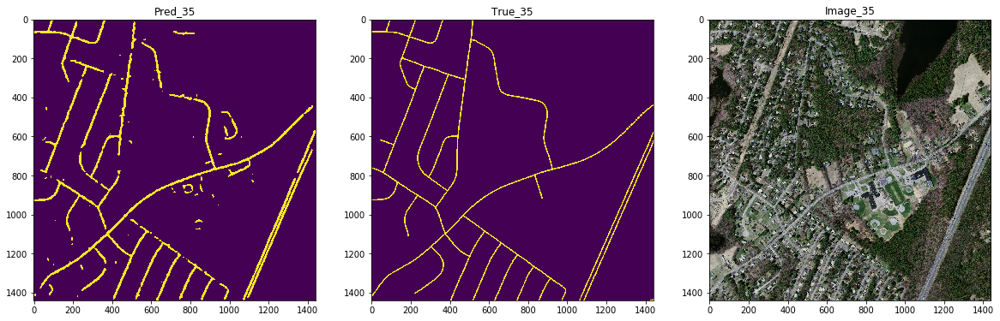

Iteration: 36  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
24029035_15.tiff
254.88790972856106


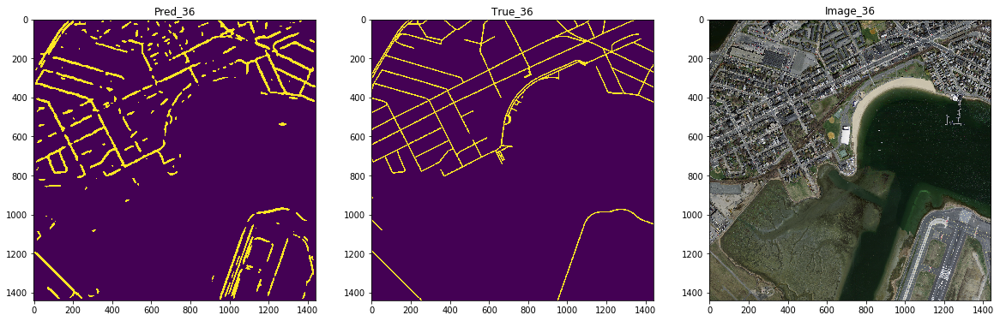

Iteration: 37  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
24478825_15.tiff
254.94329593798807


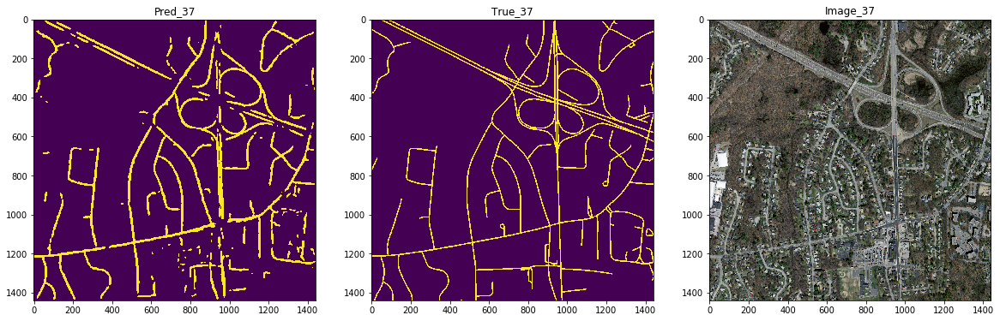

Iteration: 38  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
24478855_15.tiff
254.92183019286082


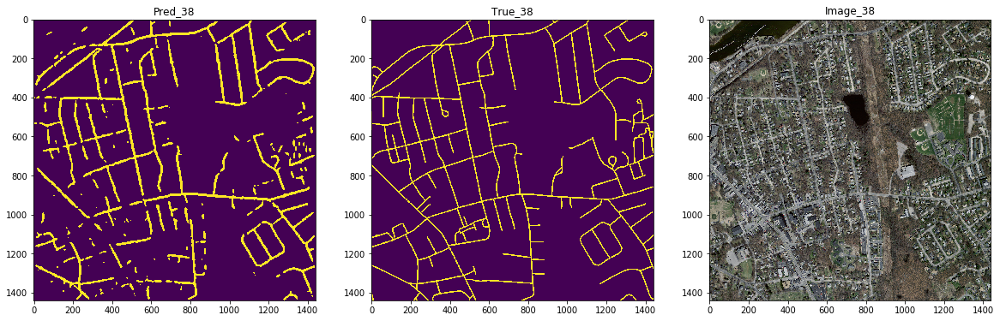

Iteration: 39  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
24479170_15.tiff
254.98731936068867


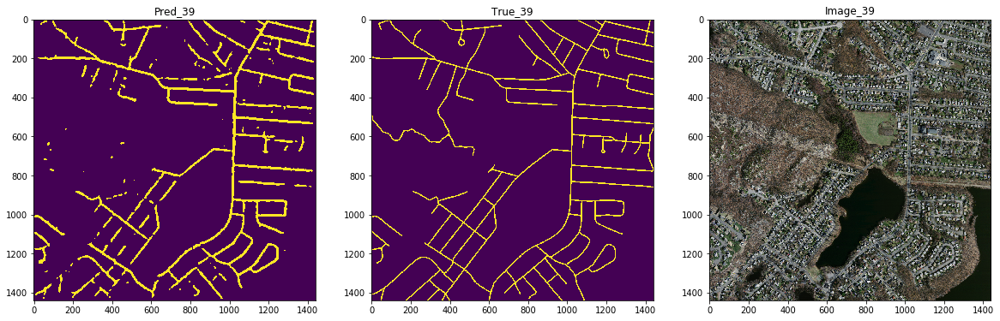

Iteration: 40  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
24479215_15.tiff
254.97162665364914


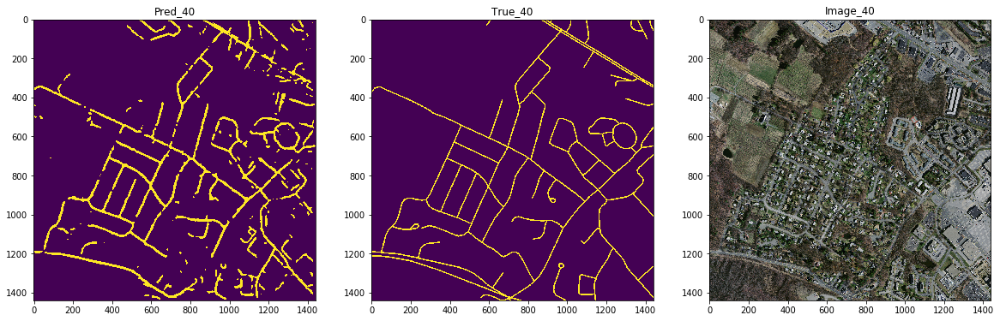

Iteration: 41  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
24628885_15.tiff
254.98525970004886


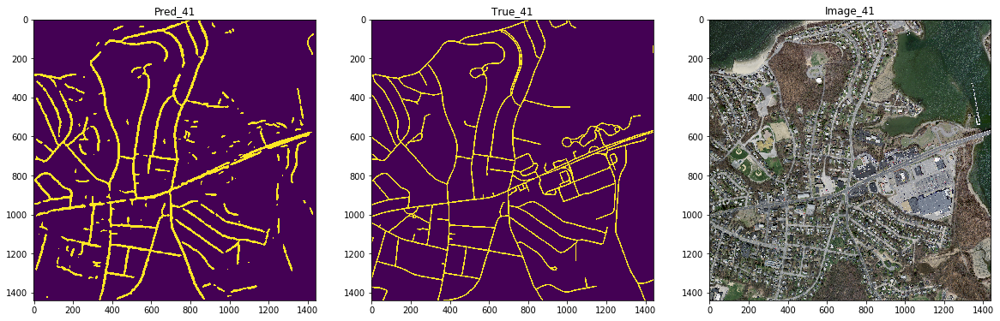

Iteration: 42  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
24629200_15.tiff
254.9960563799718


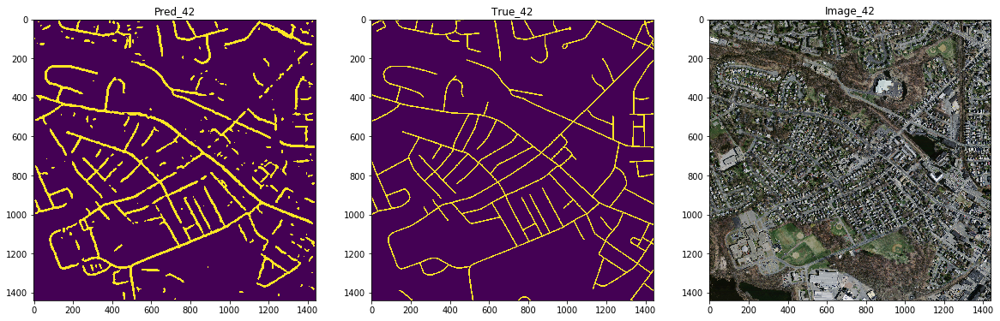

Iteration: 43  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
24779275_15.tiff
253.4814916683216


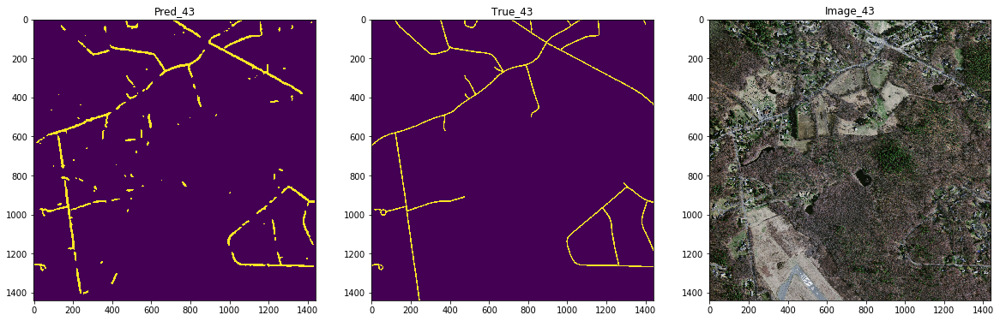

Iteration: 44  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
25079170_15.tiff
254.7792015981854


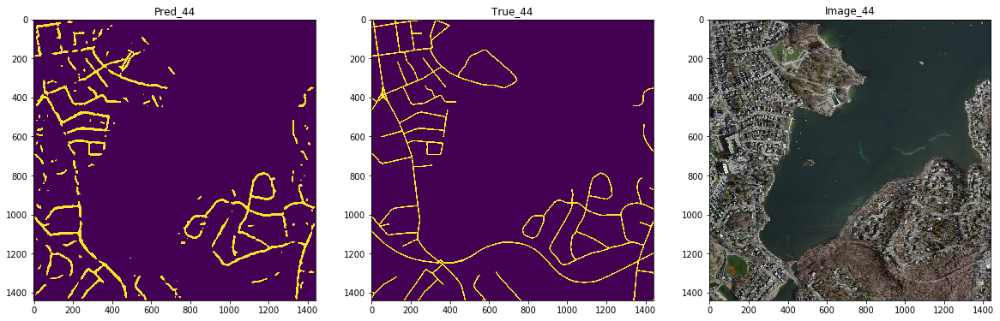

Iteration: 45  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
26278720_15.tiff
254.42543767243956


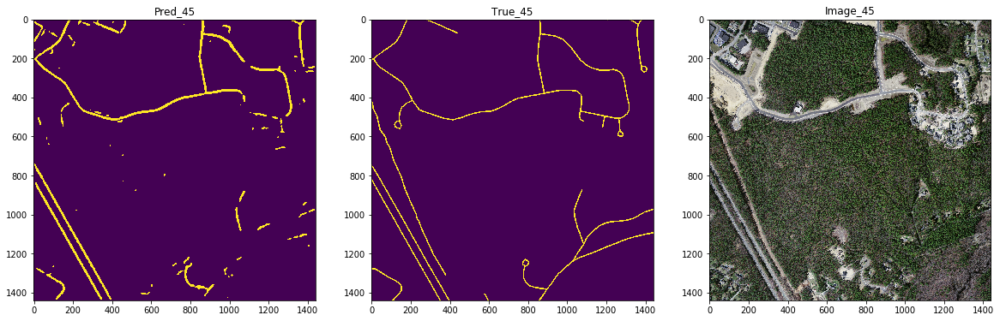

Iteration: 46  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
26428735_15.tiff
251.6774241593494


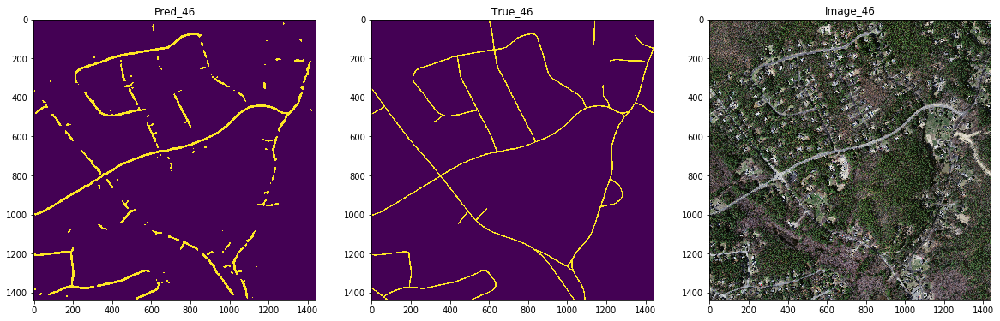

Iteration: 47  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
26578720_15.tiff
254.93473385795045


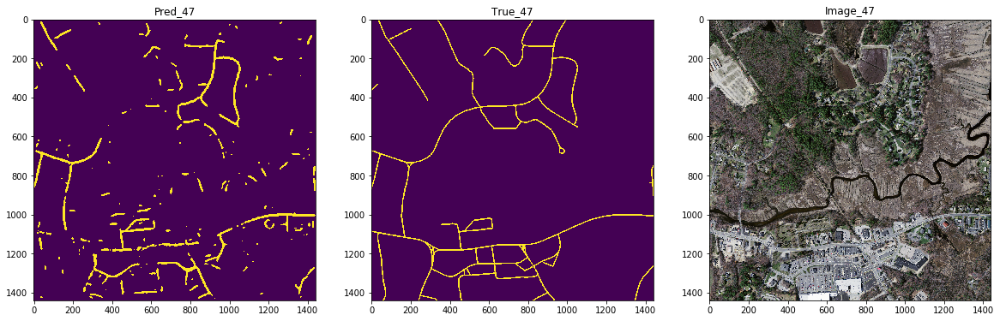

Iteration: 48  inputs:  torch.Size([1, 3, 1440, 1440]) masks: torch.Size([1, 1, 1440, 1440])
26878690_15.tiff
253.32437146303565


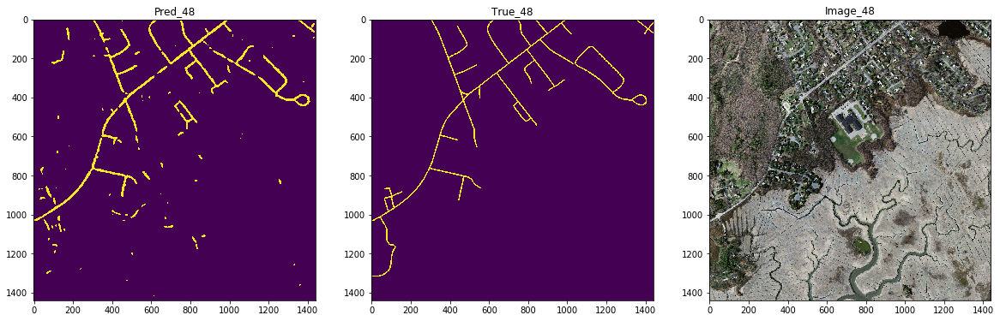

[[95472217.  1369234.]
 [ 1926995.  2837954.]]
Accuracy of the network on the 49  test images: 96 %


In [66]:
k = 0
correct = 0
total = 0
total_road = 0
conf_matrix = np.zeros([2,2])
list_road_probs = []
list_background_probs = []
total_time = 0
for i, data in enumerate(testloader, 0):
    #print(i)
#         if i>0:
#                 break

    #get inputs
    inputs, masks, names = data
    print("Iteration:", i," inputs: ", inputs.data.shape, "masks:", masks.data.shape)
    inputs, masks = Variable(inputs).cuda(), Variable(masks).long().cuda()
    #print(inputs.shape)
    #print("Iteration:", i," inputs: ", inputs.data.shape, "masks:", masks.data.shape)
    t0 = time.clock()
    mask_pred = mnih_fcn_model_test(inputs)
    t1 = time.clock()
    total_time += t1-t0
    list_road_probs.append(mask_pred.cpu().detach().numpy().reshape(-1)[masks.cpu().detach().numpy().reshape(-1) == 1])
    list_background_probs.append(mask_pred.cpu().detach().numpy().reshape(-1)[masks.cpu().detach().numpy().reshape(-1) == 0])
    #mask_pred[mask_pred>=0.5] = 1
    #mask_pred[mask_pred<0.5] = 0
    #print("Iteration:", i, " mask_pred:", mask_pred.data.shape)
    thresh = Variable(torch.Tensor([0.5])).cuda()
    mask_pred = (mask_pred >= thresh).float()*1
    mask_pred = mask_pred.view(1,1440,1440)
    masks = masks.view(1,1440,1440)
    total_road += torch.sum(masks)
    conf_matrix += confusion_matrix(masks.cpu().numpy().reshape(-1), mask_pred.cpu().numpy().reshape(-1))
    diff = masks.cpu().numpy().reshape(-1) - mask_pred.cpu().numpy().reshape(-1)
    correct += np.count_nonzero(diff==0)
    total += diff.size

    inputs0 = inputs[:,0]
    inputs1 = inputs[:,1]
    inputs2 = inputs[:,2]
    inputs2 = torch.stack([inputs0, inputs1, inputs2], dim=3)
    #print("Iteration:", i," inputs2: ", inputs2.data.shape, "masks:", masks.data.shape)
    #print("Iteration:", i, " mask_pred:", mask_pred.data.shape, "masks:", masks.data.shape)

    print(names[0])
    img_pred = mask_pred[0].cpu().detach().numpy()
    img_pred = (img_pred*255)
    img_pred = img_pred.astype(int)
    
    block_size = 15
    img_pred = threshold_local(img_pred, block_size, offset=0)
    #img_pred = cv2.Canny(img_pred,100,200)
    print(np.max(img_pred))
    img_pred[img_pred>=50] = 255
    img_pred[img_pred<50] = 0
    
    cv2.imwrite("../data/mass_roads/test_pred/"+names[0]+"_fcn.png", img_pred)
    
    plt.figure(k, figsize=(20,20))
    plt.subplot(1,3,1)
    plt.title('Pred_'+str(k))
    plt.imshow(img_pred)
    plt.subplot(1,3,2)
    plt.title('True_'+str(k))
    plt.imshow(masks[0].cpu().detach().numpy())
    plt.subplot(1,3,3)
    plt.title('Image_'+str(k))
    plt.imshow(inputs2[0])
    plt.show()
    k = k + 1
print(conf_matrix)
print('Accuracy of the network on the 49  test images: %d %%' % (
    100 * correct / total))

In [64]:
total_time/49

0.004067755101997897

In [67]:
101606400.0 - 110250000.0

-8643600.0

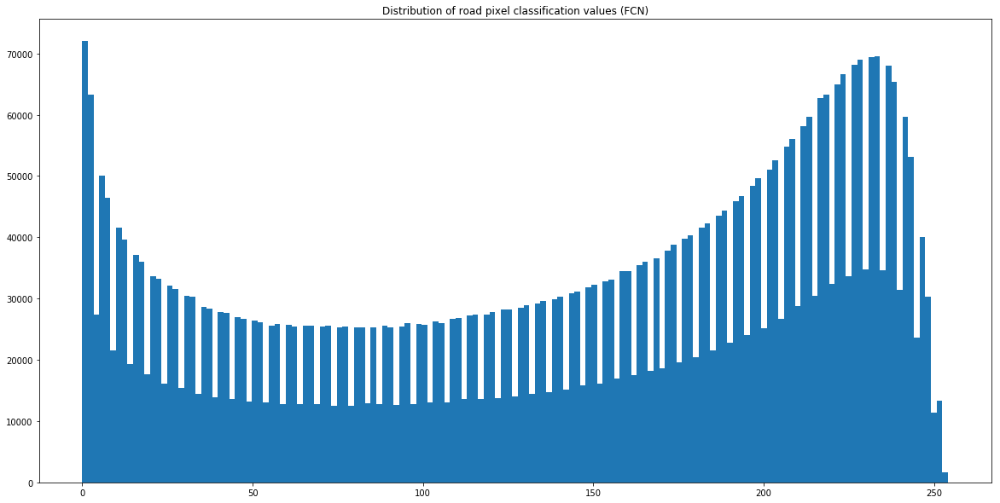

In [58]:
#list_road_probs = np.concatenate(list_road_probs).ravel()
list_road_probs2 = list_road_probs*255
list_road_probs2 = list_road_probs2.astype(int)
plt.figure(1, figsize=(20,10))
plt.hist(list_road_probs2, bins='auto')  # arguments are passed to np.histogram
plt.title("Distribution of road pixel classification values (FCN)")
plt.show()

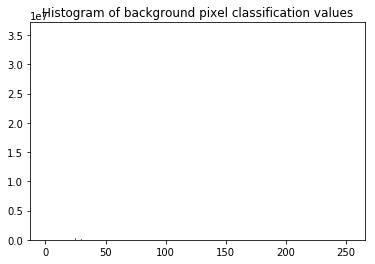

In [43]:
list_background_probs = np.concatenate(list_background_probs).ravel()
list_background_probs2 = list_background_probs*255
list_background_probs2 = list_background_probs2.astype(int)
plt.hist(list_background_probs2, bins='auto')  # arguments are passed to np.histogram
plt.title("Histogram of background pixel classification values")
plt.show()

In [53]:
list_background_probs2.shape

(96841451,)

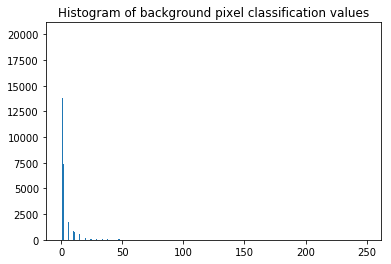

In [52]:
plt.hist(list_background_probs2[0:64949], bins='auto')  # arguments are passed to np.histogram
plt.title("Histogram of background pixel classification values")
plt.show()

In [48]:
list_road_probs.shape

(4764949,)